In [1]:
import pandas as pd
import numpy as np
import csv
from datetime import datetime
from lxml import html 
import requests
from bs4 import BeautifulSoup
from IPython.core.display import HTML
import itertools
import requests
from tqdm import tqdm
# Converting links to html tags
def path_to_image_html(path):
    return '<img src="'+ path + '" width="60" >'

In [2]:
import json

url = 'https://dat-tr-prda-ops-vava.azureedge.net/cars/56169/car-details-en.json'

response = requests.get(url).text
response_info = json.loads(response)
response2 = requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/54517/car-details-en.json").text
response_info2 = json.loads(response2)


In [35]:
response_info2

{'carId': 54517,
 'inspectionSummary': {'inspectionId': 97851,
  'registrationNumber': '06CSP169',
  'vin': 'TMAJB81BGMJ100307',
  'engineNumber': 'G4FPMZ092861',
  'registrationDate': '2021-12-04T00:00:00',
  'makeYear': 2021,
  'numberOfKeys': 2,
  'numberOfSD': 1,
  'nationalStampExpiry': '2024-07-16T00:00:00',
  'makeName': '',
  'modelName': '',
  'trimLevelName': '',
  'cityName': '',
  'purchaseCounterpartyTypeId': 1,
  'inspectionTypeId': 3,
  'preLoadQCTypeID': 3,
  'preLoadQCId': 94212},
 'conditionSummary': {'inspectionCheckPointsGroups': [{'inspectionCheckpointGroupId': 23971030,
    'inspectionId': 0,
    'checkpointGroupId': 6,
    'checkpointGroupName': 'Condition',
    'checkpointGroupCode': 'CONDITION',
    'groupTypeId': 0,
    'externalKipperDiagramCode': '',
    'internalKipperDiagramCode': '',
    'inspectionCheckPoints': [],
    'inspectionCheckPointsGroups': [{'inspectionCheckpointGroupId': 23971056,
      'inspectionId': 0,
      'checkpointGroupId': 54,
      '

In [37]:
len(df_total.columns)

63

In [3]:
response3 = requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61126/car-details-en.json").text
response_info3 = json.loads(response3)
print(response_info3['carSpecification']['registrationDate'])

2018-11-15T00:00:00


In [4]:
responseinfo2_1

NameError: name 'responseinfo2_1' is not defined

## Creando Dataframe, sobre detalles generales del coche

In [5]:
def getting_info_car(response_info2):
    
    ##1st step
    marca=[]
    marca.append(str(response_info2['carSpecification']['makeName']))
    modelo=[]
    modelo.append(str(response_info2['carSpecification']['modelName']))
    detalles=[]
    detalles.append(response_info2['carSpecification']['trimLevelName'])
    Fecha=[]
    Fecha.append(response_info2['carSpecification']['registrationDate'])

    dtcPrice=[]
    dtcPrice.append(str(response_info2['carSpecification']['dtcPrice']))
    actualMileage=[]
    actualMileage.append(str(response_info2['carSpecification']['actualMileage']))

    combustible=[]
    combustible.append(str(response_info2['carSpecification']['fuelTypeName']))
    almacen=[]
    almacen.append(str(response_info2['carSpecification']['warehouseName']))
    ID=[]
    #ID.append(str(response_info2['carSpecification']['auctionId']))
    ID.append(str(response_info2['carId']))
    imgcar=[]
    imgcar.append(response_info2['mainImageUrl'])
    df3 = pd.DataFrame(
        {'marca': marca,
         'modelo': modelo,
         'detalles': detalles,
         'Fecha': Fecha,
         'actualMileage':actualMileage,
         'Price':dtcPrice,
         'combustible': combustible,
         'almacen': almacen,
         'ID': ID,
         'imgcar':imgcar,
        })
    df3['date'] = df3['Fecha'].astype('datetime64[ns]')
    
    #2nd step
    cochecondition_elemento=[]
    cochecondition_subelemento=[]
    cochecondition_inspecciones=[]
    cochecondition_orden_inspecciones=[]
    cochecondition_informe=[]
    cochecondition_detalle=[]
    cochecondition_imagen=[]
    cochecondition_fileimagen=[]
    for i,pos in enumerate(response_info2['conditionSummary'].values()):


                for i2,pos2 in enumerate(pos[0]['inspectionCheckPointsGroups']): #son 38 diccionarios

                    #print("Estamos en el elemento "+str(i2)+" llamado "+ pos2['checkpointGroupName'] + " q tiene "+str(len(pos2['inspectionCheckPointsGroups']))+" subelementos")#cada diccionario tiene una lista de diccionarios, componentes del elemento en cuestion

                    #hay que iterar cada uno de los subelementos y ver si se han chequeado
                    for i3,pos3 in enumerate(pos2['inspectionCheckPointsGroups']):

                    #lo siguiente es mirar si hay detalles de inspecciones, y lo siguiente es mirar tb info acerca de inspecciones 
                        inspecciones=0
                        #ver inspecciones de todos print("El subelemento "+ pos3["checkpointGroupName"]+" tiene "+str(len(pos3["inspectionCheckPoints"]))+"inspecciones")
                        for i4,pos4 in enumerate(pos3['inspectionCheckPoints']):


                            inspecciones=inspecciones+1

                            
                            #print("hay "+str(len(pos4['inspectionCheckPointDetails']))+" detalles") habra x detalles pero solo nos quedamos con el true
                            for i5,pos5 in enumerate(pos4['inspectionCheckPointDetails']):
                                if pos5['isChecked']==True:
                                    cochecondition_elemento.append({'Elemento': pos2['checkpointGroupName']})
                                    cochecondition_subelemento.append({'Subelemento': pos3["checkpointGroupName"]})
                                    cochecondition_inspecciones.append({'nºInspecciones(totales)': len(pos3["inspectionCheckPoints"])})
                                    cochecondition_informe.append({'Informe de inspección':pos4['checkpointName']})
                                    cochecondition_orden_inspecciones.append({'Orden Inspección': inspecciones})
                                    if pos5['checkpointDetailName']=='Yes':
                                        #print(pos5['checkpointDetailName']+", "+pos4['checkpointName']+" inspección chequeada")

                                        cochecondition_detalle.append({'Detalle inspección':pos4["checkpointName"]+"; "+pos5['checkpointDetailName']})
                                        subpil=""
                                    else:

                                        cochecondition_detalle.append({'Detalle inspección':pos5['checkpointDetailName']})
                                        subpil=pos5['checkpointDetailName']

                                    cochecondition_imagen.append({'nºImagenes':len(pos4['documents'])})

                                    if len(pos4['documents']) >=1:

                                        cochecondition_fileimagen.append({'file_imagen':pos4['documents'][0]['documentPath']})
                                    else:
                                        cochecondition_fileimagen.append({'file_imagen':'No_hay_Imagen'})
    elementos=pd.DataFrame(cochecondition_elemento)
    subelementos=pd.DataFrame(cochecondition_subelemento)
    inspecciones=pd.DataFrame(cochecondition_inspecciones)
    Orden_inspeccion=pd.DataFrame(cochecondition_orden_inspecciones)
    informe=pd.DataFrame(cochecondition_informe)
    detalle=pd.DataFrame(cochecondition_detalle)
    imagen=pd.DataFrame(cochecondition_imagen)
    fileimagen=pd.DataFrame(cochecondition_fileimagen)
    #pd.concat([elementos,subelementos,inspecciones])
    #pd.concat([elementos,subelementos,inspecciones], axis=0, ignore_index=True)
    df1=pd.concat([elementos,subelementos,inspecciones,Orden_inspeccion,informe,detalle,imagen,fileimagen], axis=1)
    df3['condittion_summary']=[df1] 
    
    ##3rd step
    cochemechanical_elemento=[]
    cochemechanical_inspecciones=[]
    cochemechanical_orden_inspecciones=[]
    cochemechanical_informe=[]
    cochemechanical_detalle=[]
    cochemechanical_imagen=[]
    cochemechanical_fileimagen=[]
    for i,pos in enumerate(response_info2['mechanicalSummary'].values()):

                for i2,pos2 in enumerate(pos[0]['inspectionCheckPointsGroups']): #son 38 diccionarios

                    inspecciones=0
                    for i3,pos3 in enumerate(pos2['inspectionCheckPoints']):
                        inspecciones=inspecciones+1


                        for i4,pos4 in enumerate(pos3['inspectionCheckPointDetails']):
                            if pos4['isChecked']==True:
                                cochemechanical_elemento.append({'Elemento': pos2['checkpointGroupName']})
                                cochemechanical_inspecciones.append({'nºInspecciones(totales)': len(pos2["inspectionCheckPoints"])})
                                cochemechanical_orden_inspecciones.append({'Orden Inspección': inspecciones})
                                cochemechanical_informe.append({'Informe de inspección':pos3['checkpointName']})
                                if pos4['checkpointDetailName']=='Yes':
                                    cochemechanical_detalle.append({'Detalle inspección':pos4['checkpointDetailName']+", "+pos3['checkpointName']})
                                else:
                                    cochemechanical_detalle.append({'Detalle inspección':pos4['checkpointDetailName']})

                                cochemechanical_imagen.append({'nºImagenes':len(pos3['documents'])})
                                if len(pos3['documents']) >=1:

                                    cochemechanical_fileimagen.append({'file_imagen':pos3['documents'][0]['documentPath']})

                                else:
                                    cochemechanical_fileimagen.append({'file_imagen':'No_hay_Imagen'})


    elementos=pd.DataFrame(cochemechanical_elemento)
    inspecciones=pd.DataFrame(cochemechanical_inspecciones)
    Orden_inspeccion=pd.DataFrame(cochemechanical_orden_inspecciones)
    informe=pd.DataFrame(cochemechanical_informe)
    detalle=pd.DataFrame(cochemechanical_detalle)
    imagen=pd.DataFrame(cochemechanical_imagen)
    fileimagen=pd.DataFrame(cochemechanical_fileimagen)

    dfMech=pd.concat([elementos,inspecciones,Orden_inspeccion,informe,detalle,imagen,fileimagen], axis=1)
    df3['Mech_summary']=[dfMech] 
    
    #4th step
    cochefeature1_feature=[]
    cochefeature1_description=[]


    cochefeature1_imagen=[]
    cochefeature1_fileimagen=[]
    #inspeccionar esas inspecciones de cada elemento
    for i,pos in enumerate(response_info2['descriptionSummary'].values()):

                for i2,pos2 in enumerate(pos[0]['inspectionCheckPoints']): #son 38 diccionarios
                    #print()
                    #if len(pos2['inspectionCheckPointDetails'])!=0:               
                    #   print("Estamos en el elemento "+str(i2)+" llamado "+ pos2['checkpointName'] + " q tiene "+str(len(pos2['inspectionCheckPointDetails']))+" subelementos")#cada diccionario tiene una lista de diccionarios, componentes del elemento en cuestion
            #ejecutar esto de arriba para ver toooodos los elementos del cohce incluso los vacios de detalles

                    inspecciones=0
                    for i3,pos3 in enumerate(pos2['inspectionCheckPointDetails']):
                        inspecciones=inspecciones+1


                        if pos3['isChecked']==True:
                            #Yakıt Tipi-->fuel type
                            cochefeature1_feature.append({'Feature':pos2["checkpointName"]})
                            cochefeature1_description.append({'Descrption':pos3['checkpointDetailName']})
                            #print(pos3)
                            cochefeature1_imagen.append({'NºImagenes':len(pos2['documents'])})
                            if len(pos2['documents']) >=1:#esto podria ponerse fuera del for pero como solo entra en detalles true lo dejo ahi solo lo chequea 1 vez
                                #print(pos2['documents'][0]['documentPath'])
                                cochefeature1_fileimagen.append({'file_imagen':pos2['documents'][0]['documentPath']})

                            else:
                                cochefeature1_fileimagen.append({'file_imagen':'No_hay_Imagen'})

    feature=pd.DataFrame(cochefeature1_feature)
    description=pd.DataFrame(cochefeature1_description)

    imagen=pd.DataFrame(cochefeature1_imagen)
    fileimagen=pd.DataFrame(cochefeature1_fileimagen)

    dffeature1=pd.concat([feature,description,imagen,fileimagen], axis=1)

    df3['features1_summary']=[dffeature1] 
    dfeatures1 = pd.DataFrame(columns = df3['features1_summary'][0]['Feature'].values.tolist())
    dfeatures1.loc[len(dfeatures1)] = df3['features1_summary'][0]['Descrption'].values.tolist()
    #dfeatures1
    #y añadirla al df
    df3=pd.concat([df3,dfeatures1], axis=1)

    v=df3['features1_summary'][0]['NºImagenes'].unique()==0
    if v[0]==True:
        del df3['features1_summary']
        
    cochefeature2_feature=[]
    cochefeature2_inspecciones=[]
    cochefeature2_orden_inspecciones=[]
    cochefeature2_componentfeature2=[]
    cochefeature2_detalle=[]
    cochefeature2_imagen=[]
    cochefeature2_fileimagen=[]
    #inspeccionar esas inspecciones de cada elemento
    for i,pos in enumerate(response_info2['descriptionSummary'].values()):

                for i2,pos2 in enumerate(pos[0]['inspectionCheckPointsGroups']): #son 38 diccionarios
                    #print(pos2['checkpointGroupName'])
                    inspecciones=0

                    for i3,pos3 in enumerate(pos2['inspectionCheckPoints']):
                        #print(pos3)
                        inspecciones=inspecciones+1
                        
                        for i4,pos4 in enumerate(pos3['inspectionCheckPointDetails']):

                            if pos4['isChecked']==True:
                                cochefeature2_feature.append({'Feature':pos2['checkpointGroupName']})
                                cochefeature2_inspecciones.append({'NºInspecciones':len(pos2['inspectionCheckPoints'])})
                                cochefeature2_orden_inspecciones.append({'Orden Inspección': inspecciones})
                                cochefeature2_componentfeature2.append({'Feature Component':pos3["checkpointName"]})
                                cochefeature2_detalle.append({'Detalle':pos4['checkpointDetailName']})

                                cochefeature2_imagen.append({'NºImagen':len(pos3['documents'])})
                                if len(pos3['documents']) >=1:#esto podria ponerse fuera del for pero como solo entra en detalles true lo dejo ahi solo lo chequea 1 vez
                                    cochefeature2_fileimagen.append({'file_imagen':pos3['documents'][0]['documentPath']})
                                else:
                                    cochefeature2_fileimagen.append({'file_imagen':'No_hay_Imagen'})



    feature=pd.DataFrame(cochefeature2_feature)
    inspecciones=pd.DataFrame(cochefeature2_inspecciones)
    Orden_inspeccion=pd.DataFrame(cochefeature2_orden_inspecciones)
    componentfeature2=pd.DataFrame(cochefeature2_componentfeature2)
    cochefeature2_detalle=pd.DataFrame(cochefeature2_detalle)
    imagen=pd.DataFrame(cochefeature2_imagen)
    fileimagen=pd.DataFrame(cochefeature2_fileimagen)

    dfeatures2=pd.concat([feature,inspecciones,Orden_inspeccion,componentfeature2,cochefeature2_detalle,imagen,fileimagen], axis=1)
    df3['features2_summary']=[dfeatures2] 
    # Rendering the dataframe as HTML table
    try:
        df3_1=df3[['marca', 'modelo', 'detalles', 'Fecha', 'actualMileage', 'Price',
               'combustible', 'almacen', 'ID', 'imgcar', 'date',
                'Body type', 'Color', 'Number of doors',
               'Wheel drive', 'Transmission', 'Seating capacity']]
    except:
        df3_1=[]
    
    return [df3,HTML(df3_1.to_html(escape=False,formatters=dict(imgcar=path_to_image_html)))]

In [11]:
dfs=pd.read_csv('muestra_coche_TOTAL_van_del_44702_al_56799.csv')
dfs.loc[[2]]

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,Mech_summary,Body type,Color,Number of doors,Fuel type,Wheel drive,Transmission,Seating capacity,features2_summary,Yakıt Tipi
2,a2a1bc70-fe54-49f3-9378-17256dc10b63,44709,4,Renault,Clio,218000.0,218000.0,2019,2021-11-25T11:02:53.0447555+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Kırmızı,5,Diesel,Front Wheel Drive,Manual,5,Feature NºInspecciones Orden Inspección Fe...,NaN


In [6]:
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61427/car-details-en.json").text))[0]
df

,marca,modelo,detalles,Fecha,actualMileage,Price,combustible,almacen,ID,imgcar,...,condittion_summary,Mech_summary,Body type,Color,Number of doors,Yakıt Tipi,Wheel drive,Transmission,Seating capacity,features2_summary
0,Suzuki,Vitara,1.4 Boosterjet 4x2 Gl Plus Çift Renk 140HP,2020-12-24T00:00:00,23630,404000.0,Benzin,Basaksehir Warehouse,61427,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento Subelemento nºInspeccion...,Elemento nºInspecciones(totales) Or...,SUV,Sarı,5,Benzin,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden ...


In [18]:
df['condittion_summary'][0].iloc[4:7]

,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
4,Front Bumper,Front Bumper,1,1,Scratch,less than 1.5 inches/37.5mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
5,R front wing,R Front Fender,1,1,Scratch,less than 6 inches/150mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
6,R Front rim,R Front rim,1,1,Scratch,less than 1.5 inches/37.5mm,1,https://prvtrprdaopsvava.blob.core.windows.net...


In [7]:
info=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61429/car-details-en.json").text))[1]
info

,marca,modelo,detalles,Fecha,actualMileage,Price,combustible,almacen,ID,imgcar,date,Body type,Color,Number of doors,Wheel drive,Transmission,Seating capacity
0,Volkswagen,Polo,1.0 Trendline 75HP,2015-09-29T00:00:00,68201,201000.0,Benzin,Basaksehir Warehouse,61429,,2015-09-29,Hatchback,Beyaz,5,Front Wheel Drive,Manual,5


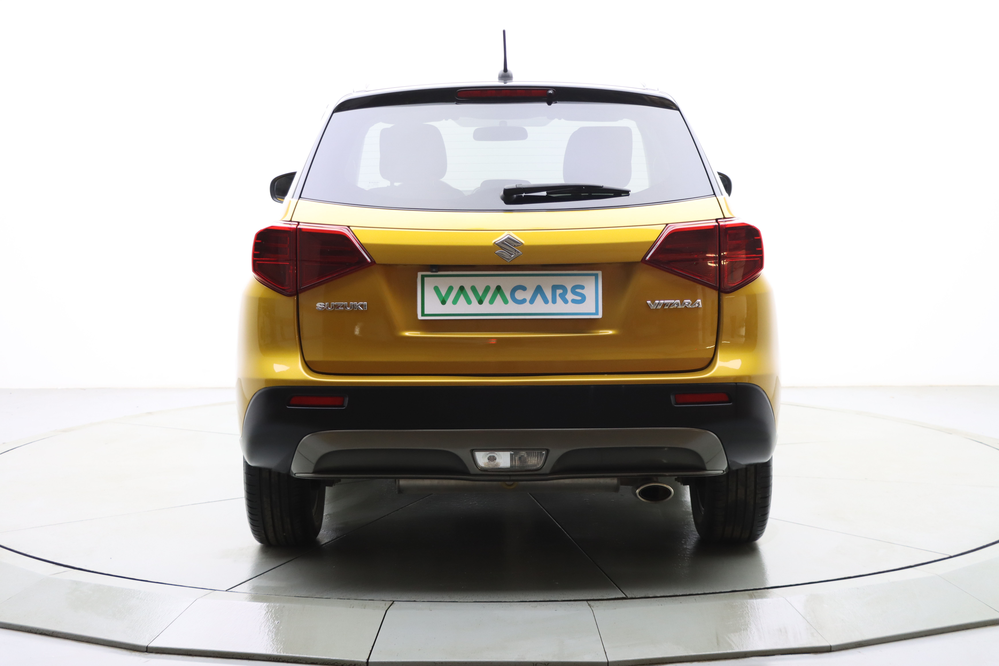

In [55]:
import requests
from PIL import Image
from io import BytesIO
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61427/car-details-en.json").text))[0]


r = requests.get(df['imgcar'][0])
im2 = Image.open(BytesIO(r.content))
im2


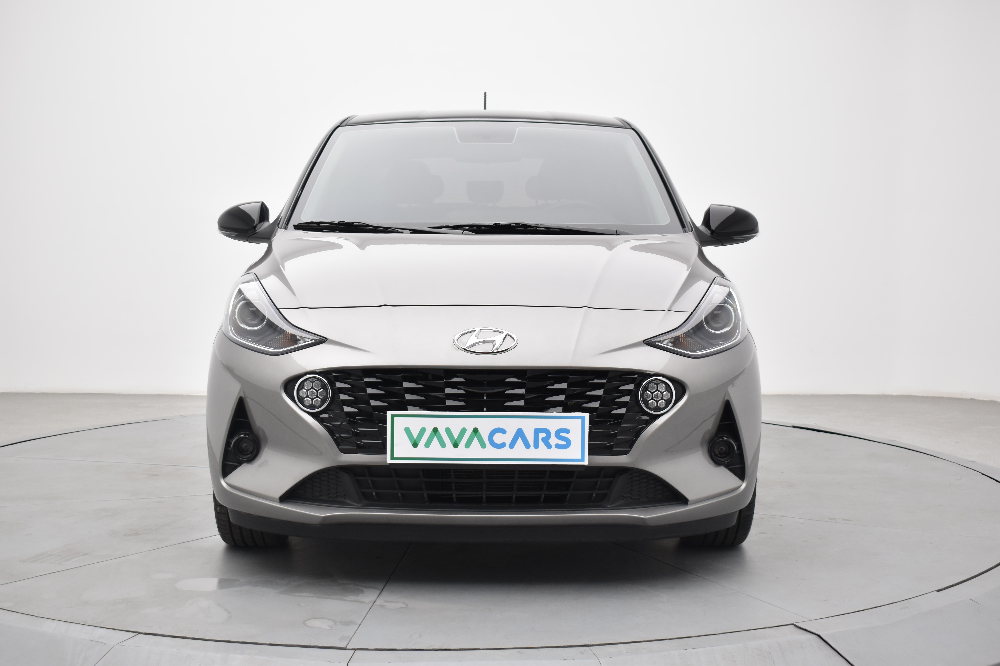

In [56]:
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/56169/car-details-en.json").text))[0]


r = requests.get(df['imgcar'][0])
im = Image.open(BytesIO(r.content))
im

In [6]:
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61427/car-details-en.json").text))[0]

df['Mech_summary'][0]

,Elemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Brakes,2,1,Brakes,Disks are worn,0,No_hay_Imagen
1,Brakes,2,1,Brakes,Pads are worn,0,No_hay_Imagen
2,Brakes,2,1,Brakes,Disks are rusty,0,No_hay_Imagen
3,Brakes,2,2,Rear Brakes,Diskler Paslı,0,No_hay_Imagen
4,Brakes,2,2,Rear Brakes,Diskler Yıpranmış,0,No_hay_Imagen
5,Brakes,2,2,Rear Brakes,Balatalar aşınmış,0,No_hay_Imagen
6,Exhaust,3,1,Catalytic converter,Rusty,0,No_hay_Imagen
7,Exhaust,3,2,Manifold,Rusty,0,No_hay_Imagen
8,Exhaust,3,3,Exhaust,Defect,1,https://prvtrprdaopsvava.blob.core.windows.net...
9,Exhaust,3,3,Exhaust,Rusty,1,https://prvtrprdaopsvava.blob.core.windows.net...


In [7]:
df['condittion_summary'][0]

,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Hood,Inside,1,1,Damage,Damage; Yes,1,https://prvtrprdaopsvava.blob.core.windows.net...
1,Hood,Hood,3,1,Wave or repaired area,3 inches/75mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
2,Hood,Hood,3,2,Dismantled / Installed,Evet,1,https://prvtrprdaopsvava.blob.core.windows.net...
3,Hood,Hood,3,3,Bird Drop,Bird Drop; Yes,1,https://prvtrprdaopsvava.blob.core.windows.net...
4,Front Bumper,Front Bumper,1,1,Scratch,less than 1.5 inches/37.5mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
5,R front wing,R Front Fender,1,1,Scratch,less than 6 inches/150mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
6,R Front rim,R Front rim,1,1,Scratch,less than 1.5 inches/37.5mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
7,Roof,Roof,1,1,Bird Drop,Bird Drop; Yes,1,https://prvtrprdaopsvava.blob.core.windows.net...
8,R Front door,R Front door,1,1,Scratch,less than 6 inches/150mm,1,https://prvtrprdaopsvava.blob.core.windows.net...
9,R Rear door,R Rear door,1,1,Scratch,less than 1.5 inches/37.5mm,1,https://prvtrprdaopsvava.blob.core.windows.net...


In [65]:
df['features2_summary'][0]

,Feature,NºInspecciones,Orden Inspección,Feature Component,Detalle,NºImagen,file_imagen
0,Exterior equipment,1,1,Exterior equipment,Geri görüş kamerası,0,No_hay_Imagen
1,Interior equipment,3,1,Interior equipment,Isıtmalı ön koltuklar,0,No_hay_Imagen
2,Interior equipment,3,1,Interior equipment,Elektronik klima,0,No_hay_Imagen
3,Interior equipment,3,1,Interior equipment,Hız sabitleme/limitleme,0,No_hay_Imagen
4,Interior equipment,3,1,Interior equipment,Kol dayama (ön),0,No_hay_Imagen
5,Interior equipment,3,1,Interior equipment,Start/stop,0,No_hay_Imagen
6,Interior equipment,3,2,Climate or Infotainment,Bluetooth,0,No_hay_Imagen
7,Interior equipment,3,2,Climate or Infotainment,DVD screen,0,No_hay_Imagen
8,Interior equipment,3,2,Climate or Infotainment,Electric airconditioning,0,No_hay_Imagen
9,Interior equipment,3,2,Climate or Infotainment,Navigation system,0,No_hay_Imagen


In [19]:
df3_1=df['condittion_summary'][0].iloc[4:7]
HTML(df3_1.to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))

,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
4,Front Bumper,Front Bumper,1,1,Scratch,less than 1.5 inches/37.5mm,1,
5,R front wing,R Front Fender,1,1,Scratch,less than 6 inches/150mm,1,
6,R Front rim,R Front rim,1,1,Scratch,less than 1.5 inches/37.5mm,1,


## Metodo cogerimagenescoche main info

In [5]:
#notvalid

In [20]:
def getting_info_main_car(responseinfo2_1):
    
    ##1st step
    dfs_ri2=[]
    for i,pos in enumerate(responseinfo2_1):
            if pos!='images' and responseinfo2_1[pos]!=[]:
                if isinstance(responseinfo2_1[pos], list):
                    if len(responseinfo2_1[pos])==1:
                        datas=pd.DataFrame({pos:responseinfo2_1[pos][0]}, index=[0])
                        dfs_ri2.append(pd.DataFrame(datas))
                else:
                    datas=pd.DataFrame({pos:responseinfo2_1[pos]}, index=[0])
                    dfs_ri2.append(pd.DataFrame(datas))  
    dfs_ri2=pd.concat(dfs_ri2,axis=1)
    
    dfs_ri2['date'] = dfs_ri2['vehicleAddedDate'].astype('datetime64[ns]')
    #2nd step
    images=[]
    imagesExterior=[]
    imagesInterior=[]
    imagesImperfections=[]
    imgtype=[]
    for i,pos in enumerate(responseinfo2_1['images']):
        imgtype.append(pos['type'])
        images.append(pos['url'])
        if pos['type']=='Exterior':
            imagesExterior.append(pos['url'])
        elif pos['type']=='Interior':
            imagesInterior.append(pos['url'])
        elif pos['type']=='Imperfections':
            imagesImperfections.append(pos['url'])
    dfs_ri2['images']=[images]
    dfs_ri2['imagesExterior']=[imagesExterior]
    dfs_ri2['imagesInterior']=[imagesInterior]
    dfs_ri2['imagesImperfections']=[imagesImperfections] 
    dfimg=pd.DataFrame({'Imgs':images})
    dfimg['type']=imgtype
    df3_1=dfimg
    HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))
 
    
    return [dfs_ri2,df3_1,HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))]

In [7]:
#pd.DataFrame({'ids':[true_ids]}).to_csv('ids.csv',index=False)

In [14]:
#poner los car id y marca en base al df grande construido
dfs=pd.read_csv('muestra_coche_TOTAL_van_del_44702_al_56799.csv')
dfs.loc[[2]]

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,Mech_summary,Body type,Color,Number of doors,Fuel type,Wheel drive,Transmission,Seating capacity,features2_summary,Yakıt Tipi
2,a2a1bc70-fe54-49f3-9378-17256dc10b63,44709,4,Renault,Clio,218000.0,218000.0,2019,2021-11-25T11:02:53.0447555+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Kırmızı,5,Diesel,Front Wheel Drive,Manual,5,Feature NºInspecciones Orden Inspección Fe...,NaN


In [22]:
ids=834
#link="https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/"+dfs.loc[[ids]]['make'].values.tolist()[0]+"/purchases/"+str(dfs.loc[[ids]]['vehiclePurchaseId'].values.tolist()[0])
link='https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/Hyundai/purchases/54517'

In [23]:
responseinfo2_1=json.loads(requests.get(link).text)

In [24]:
getting_info_main_car(responseinfo2_1)[0]#aqui tengo una columna con informacion de las imagenes

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,color,paintType,vatPercentage,locationCity,unavailable,date,images,imagesExterior,imagesInterior,imagesImperfections
0,1e0f7377-f167-49cd-b1d4-f5fd19229eb4,54517,4,Hyundai,Tucson,587000.0,587000.0,2021,2021-12-29T14:32:44.3739515+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,Dark blue,Metalik,0.0,Ankara,True,2021-12-29 14:32:44.373951500,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...


In [26]:
getting_info_main_car(responseinfo2_1)[2]

,Imgs,type
0,,Interior
1,,Interior
2,,Interior
3,,Interior
4,,Interior
5,,Interior
6,,Interior
7,,Exterior
8,,Exterior
9,,Exterior


In [68]:
#lo mismo aqui buscar por la id de la row del dataframe
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/"+  str(dfs.loc[[ids]]['vehiclePurchaseId'].values.tolist()[0])  +"/car-details-en.json").text))[0]

HTML(df['condittion_summary'][0].to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))#la 5 y 10 fila match las imperfections 37 y51 es la img 2


,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Front Bumper,Front Bumper,1,1,Scratch,3 inches/75mm,2,
1,R front wing,R front fender,1,1,Scratch,3 inches/75mm,1,
2,Roof,Roof,1,1,Bird Drop,Bird Drop; Yes,1,
3,R Front door,R Front door,2,1,Scratch,3 inches/75mm,1,
4,R Front door,R Front door,2,2,Dent,less than 1.5 inches/37.5mm,1,
5,R Rear door,Handle,1,1,Scratch,3 inches/75mm,1,
6,R Rear wing,R Rear Fender,1,1,Paint Deformation,less than 4.5 inches/112.5mm,0,
7,R Rear light,R Rear light,1,1,Scratch,less than 1.5 inches/37.5mm,1,
8,Rear hood,Rear hood,2,1,Bird Drop,Bird Drop; Yes,1,
9,Rear hood,Rear hood,2,2,Paint Deformation,3 inches/75mm,1,


In [28]:
import pickle
with open('all_info_37590_70126_V2.head.pkl', 'rb') as inp:
    df_total = pickle.load(inp)
df_total=df_total.reset_index()
del df_total['index']

df_total.columns

Index(['id', 'vehiclePurchaseId', 'status', 'make', 'model', 'price',
       'priceBeforeDiscount', 'year', 'vehicleAddedDate', 'mainImageUrl',
       'plateNumber', 'mileage', 'transmission', 'transmissionName',
       'fuelType', 'driveType', 'generalComment', 'carFeaturesDescription',
       'bodyType', 'seatingCapacity', 'doorCount', 'trimLevel',
       'engineHorsePower', 'engineType', 'engineVolume', 'engineVolumeLiters',
       'engineNumber', 'vin', 'numberOfKeys', 'numberOfCD', 'color',
       'paintType', 'vatPercentage', 'locationCity', 'unavailable', 'date_x',
       'images', 'imagesExterior', 'imagesInterior', 'imagesImperfections',
       'marca', 'modelo', 'detalles', 'Fecha', 'actualMileage', 'Price',
       'combustible', 'almacen', 'imgcar', 'date_y', 'condittion_summary',
       'Mech_summary', 'Body type', 'Color', 'Number of doors', 'Fuel type',
       'Wheel drive', 'Transmission', 'Seating capacity', 'features2_summary',
       'carFeaturesCodes', 'tags', 'Yakıt

In [34]:
df_total.iloc[[2]]['imagesExterior']

2    [https://dat-tr-prda-ops-vava.azureedge.net/ca...
Name: imagesExterior, dtype: object

In [62]:
HTML(df['Mech_summary'][0].to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))#la 12 fila es la imperfections es la img 2


,Elemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Tyres,6,1,Current tyres,Yaz lastiği,2,
1,Tyres,6,2,Spare Tyre,Hayır,0,
2,Tyres,6,3,Sağ Ön Lastik,Goodyear,0,
3,Tyres,6,4,Sol Ön Lastik,Goodyear,0,
4,Tyres,6,5,Sağ Arka Lastik,Goodyear,2,
5,Tyres,6,6,Sol Arka Lastik,Goodyear,0,


In [230]:
getting_info_main_car(responseinfo2_1)[0]['imagesExterior'][0][:2]#así accedo a las imagenes del coche que sea

['https://dat-tr-prda-ops-vava.azureedge.net/cars/51028/documents/d2da5af17bb24d6cbed189b8b239eb5c.JPG',
 'https://dat-tr-prda-ops-vava.azureedge.net/cars/51028/documents/9d08ba1ad5464507bf13a0a27c2a4ddb.JPG']

In [42]:
probandometodo=getting_info_main_car(json.loads(requests.get("https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/"+dfprb.loc[[283]]['marca'].values.tolist()[0]+"/purchases/"+str(dfprb.loc[[283]]['vehiclePurchaseId'].values.tolist()[0])).text))
probandometodo[0]       

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,color,paintType,vatPercentage,locationCity,unavailable,date,images,imagesExterior,imagesInterior,imagesImperfections
0,0d9f1b7d-6946-4398-8ca7-de3b30fc32dc,45543,4,Volkswagen,Tiguan,560000.0,560000.0,2020,2021-11-23T10:56:49.9766074+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,White,Opak,0.0,İstanbul,True,2021-11-23 10:56:49.976607400,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...


In [48]:
probandometodo[0]["IMGSCOM"]=[probandometodo[2]]
probandometodo[0]["IMGSCOM"][0]

,Imgs,type
0,,Interior
1,,Interior
2,,Interior
3,,Interior
4,,Interior
5,,Interior
6,,Interior
7,,Exterior
8,,Exterior
9,,Exterior


## Obteniendo dataframes con coches 

In [8]:
dfs=[]

In [9]:
fake_ids=[]
true_ids=[]
dfs=[]
fake_ids2=[]
true_ids2=[]

fake_ids3=[]
true_ids3=[]
dfs2=[]
dfsv2=[]
dfsv3=[]
for i in tqdm(range(44702,56799)):
    try:
        dfs1=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/"+str(i)+"/car-details-en.json").text))[0]

        true_ids.append(i)
        dfs.append(dfs1)

        try:
            dfs2=getting_info_main_car(json.loads(requests.get("https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/"+dfs[-1]['marca'].values.tolist()[0]+"/purchases/"+str(dfs[-1]['ID'].values.tolist()[0])).text))
            dfsv2.append(dfs2)
            dfsv3.append(dfs2[0])
            true_ids3.append(i)                            
        except:
            fake_ids3.append(i)
            
            
    except:
        fake_ids.append(i)

100%|██████████████████████████████████████████████████████████████████████████| 12097/12097 [1:04:50<00:00,  3.11it/s]


In [11]:
len(dfs)

4321

In [38]:
responseinfo2_1=json.loads(requests.get(link).text)
getting_info_main_car(responseinfo2_1)[0]

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,color,paintType,vatPercentage,locationCity,unavailable,date,images,imagesExterior,imagesInterior,imagesImperfections
0,a01fe9bd-214a-43ef-9a84-0fbef7080231,45372,4,Renault,Megane,375000.0,375000.0,2021,2021-12-02T17:47:10.4781571+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,White,Metalik,0.0,İstanbul,True,2021-12-02 17:47:10.478157100,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[]


In [12]:
df_can=pd.concat(dfs)
df_can.rename(columns={'ID':'vehiclePurchaseId'}, inplace=True)
df_can[["vehiclePurchaseId"]] = df_can[["vehiclePurchaseId"]].astype("int") #cambiar tipos de columnas. change datatype
df_can#renombrar columnas 

,marca,modelo,detalles,Fecha,actualMileage,Price,combustible,almacen,vehiclePurchaseId,imgcar,...,Mech_summary,Body type,Color,Number of doors,Fuel type,Wheel drive,Transmission,Seating capacity,features2_summary,Yakıt Tipi
0,Volkswagen,T-Roc,1.5 Tsi Act Highline Dsg 150HP,2020-08-24T00:00:00,9329,489000.0,Benzin,Ankara Warehouse,44703,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,SUV,Beyaz,5,Petrol,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden Inspección Fe...,NaN
0,Nissan,Micra,1.0 IG-T Tekna Cvt 92HP,2021-07-26T00:00:00,2413,325000.0,Benzin,Basaksehir Warehouse,44705,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Açık gri,5,Petrol,Front Wheel Drive,Automatic,5,Feature NºInspecciones Or...,NaN
0,Renault,Clio,1.5 Dci Touch 90HP,2021-06-08T00:00:00,85876,218000.0,Dizel,Basaksehir Warehouse,44709,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Kırmızı,5,Diesel,Front Wheel Drive,Manual,5,Feature NºInspecciones Orden Inspección Fe...,NaN
0,Fiat,Egea,1.4 16v Fire Street 95HP,2021-03-01T00:00:00,30789,201000.0,Benzin,Ankara Warehouse,44715,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Beyaz,5,Petrol,Front Wheel Drive,Manual,5,Feature NºInspecciones Or...,NaN
0,Nissan,Qashqai,1.5 Dci Tekna Dct 115HP,2020-08-18T00:00:00,16348,429000.0,Dizel,Basaksehir Warehouse,44717,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,SUV,Koyu mavi,5,Diesel,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden I...,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,Seat,Arona,1.6 Tdi Scr Start&Stop Xcellence Dsg 95HP,2021-08-19T00:00:00,6211,435000.0,Dizel,Maltepe Warehouse,56786,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) O...,SUV,Kırmızı,5,Diesel,Front Wheel Drive,Automatic,5,Feature NºInspecciones Ord...,NaN
0,Ford,Focus,1.5 Ti-VCT Trend X 123HP,2021-11-15T00:00:00,1178,355000.0,Benzin,Maltepe Warehouse,56787,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) O...,Hatchback,Beyaz,5,Petrol,Front Wheel Drive,Manual,5,Feature NºInspecciones Orden Inspección Fe...,NaN
0,Ford,Focus,1.5 Ti-VCT Trend X 123HP,2021-12-10T00:00:00,9820,404000.0,Benzin,Ankara Warehouse,56791,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Sedan,Beyaz,4,Petrol,Front Wheel Drive,Manual,5,Feature NºInspecciones Orden Inspección Fe...,NaN
0,Seat,Ibiza,1.0 Ecotsi Start&Stop Style Dsg 115HP,2020-08-19T00:00:00,21982,318000.0,Benzin,Maltepe Warehouse,56794,https://prvtrprdaopsvava.blob.core.windows.net...,...,Empty DataFrame Columns: [] Index: [],Hatchback,Beyaz,5,Petrol,Front Wheel Drive,Automatic,5,Feature NºInspecciones Ord...,NaN


In [13]:
dfprb=pd.concat(dfsv3).merge(df_can, on='vehiclePurchaseId', how='left')
dfprb.columns

Index(['id', 'vehiclePurchaseId', 'status', 'make', 'model', 'price',
       'priceBeforeDiscount', 'year', 'vehicleAddedDate', 'mainImageUrl',
       'plateNumber', 'mileage', 'transmission', 'transmissionName',
       'fuelType', 'driveType', 'generalComment', 'carFeaturesDescription',
       'bodyType', 'seatingCapacity', 'doorCount', 'trimLevel',
       'engineHorsePower', 'engineType', 'engineVolume', 'engineVolumeLiters',
       'engineNumber', 'vin', 'numberOfKeys', 'numberOfCD', 'color',
       'paintType', 'vatPercentage', 'locationCity', 'unavailable', 'date_x',
       'images', 'imagesExterior', 'imagesInterior', 'imagesImperfections',
       'carFeaturesCodes', 'tags', 'marca', 'modelo', 'detalles', 'Fecha',
       'actualMileage', 'Price', 'combustible', 'almacen', 'imgcar', 'date_y',
       'condittion_summary', 'Mech_summary', 'Body type', 'Color',
       'Number of doors', 'Fuel type', 'Wheel drive', 'Transmission',
       'Seating capacity', 'features2_summary', 'Yakıt

In [25]:
df3_1=dfprb.loc[588]['condittion_summary']
HTML(df3_1.to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))

,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Hood,Hood,1,1,Stone Scratch,Stone Scratch; Yes,1,
1,Front Bumper,Front Bumper,2,1,Scratch,less than 1.5 inches/37.5mm,1,
2,Front Bumper,Front Bumper,2,2,Damage,Damage; Yes,1,
3,Front Bumper,Front Shutter,1,1,Damage,Damage; Yes,1,
4,R front light,R front light,1,1,Scratch,less than 1.5 inches/37.5mm,1,
5,R front wing,R Front Fender,1,1,Chipped,1-5,1,
6,R Front rim,R Front rim,1,1,Scratch,3 inches/75mm,1,
7,Front Windscreen,Front Windscreen Wiper,1,1,Scratch,Scratch; Yes,1,
8,R Front door,R Front door,1,1,Scratch,less than 4.5 inches/112.5mm,1,
9,R Rear door,R Rear door,2,1,Dent,less than 1.5 inches/37.5mm,1,


In [56]:
dfimg=pd.DataFrame({'Imgs':dfprb.loc[585]['imagesImperfections'],'Type':'Imperfections'})#la img 3 de abajo matches la 9?
df3_1=dfimg
HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))

,Imgs,Type
0,,Imperfections
1,,Imperfections
2,,Imperfections
3,,Imperfections
4,,Imperfections
5,,Imperfections
6,,Imperfections
7,,Imperfections
8,,Imperfections
9,,Imperfections


In [27]:
dfprb.loc[[580]]

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,Mech_summary,Body type,Color,Number of doors,Fuel type,Wheel drive,Transmission,Seating capacity,features2_summary,Yakıt Tipi
580,522304f2-1d78-4fdc-9b72-e5aab73635cd,46762,2,Skoda,Fabia,283000.0,283000.0,2018,2021-11-23T10:58:31.2339381+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,Elemento nºInspecciones(totales) Orden In...,Hatchback,Beyaz,5,Petrol,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden ...,NaN


In [28]:
dfimg=pd.DataFrame({'Imgs':dfprb.loc[585]['imagesExterior']})
df3_1=dfimg
HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))

,Imgs
0,
1,
2,
3,
4,
5,
6,
7,
8,
9,


In [10]:
dfprb.to_csv('muestra_coche_TOTAL_van_del_44702_al_56799.csv',index=False)

NameError: name 'dfprb' is not defined

In [70]:
numberrow=159
df3_1=dfprb.loc[[numberrow]]['Mech_summary'][numberrow]
print(dfprb.loc[[numberrow]]['make']+": "+dfprb.loc[[numberrow]]['model'])
HTML(df3_1.to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))

159    Fiat: Egea
dtype: object


,Elemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Under carriage,1,1,Bottom Conservation Bakelites,Damaged,1,
1,Wheels,2,1,Wheel Caps,"Yes, Wheel Caps",1,
2,Wheels,2,2,Spare tyre,"Yes, Spare tyre",0,
3,Tyres,6,1,Current tyres,Yaz lastiği,2,
4,Tyres,6,2,Spare Tyre,Evet,1,
5,Tyres,6,3,Sağ Ön Lastik,Goodyear,0,
6,Tyres,6,4,Sol Ön Lastik,Goodyear,0,
7,Tyres,6,5,Sağ Arka Lastik,Goodyear,2,
8,Tyres,6,6,Sol Arka Lastik,Goodyear,0,


In [71]:
dfimg=pd.DataFrame({'Imgs':dfprb.loc[numberrow]['imagesExterior']})
df3_1=dfimg
print(dfprb.loc[[numberrow]]['make']+": "+dfprb.loc[[numberrow]]['model'])
HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))

159    Fiat: Egea
dtype: object


,Imgs
0,
1,
2,
3,
4,
5,
6,
7,
8,
9,


In [11]:
dfs=pd.read_csv('muestra_desperfectos_v1.csv')
dfs

,marca,modelo,detalles,Fecha,actualMileage,Price,combustible,almacen,ID,imgcar,...,Mech_summary,Body type,Color,Number of doors,Fuel type,Wheel drive,Transmission,Seating capacity,features2_summary,Yakıt Tipi
0,Opel,Astra,Sedan 1.6 Cdti Start&Stop Design 136HP,2021-11-26T00:00:00,62380,291000.0,Dizel,Maltepe Warehouse,38121,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Ord...,Sedan,Beyaz,4,Diesel,Front Wheel Drive,Manual,5,Feature NºInspecciones Or...,NaN
1,Seat,Leon,1.6 Tdi Start&Stop Fr Dsg 115HP,2019-03-27T00:00:00,83053,0.0,Dizel,Basaksehir Warehouse,34834,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden...,Hatchback,Beyaz,5,Diesel,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden Inspección Fe...,NaN
2,Mercedes-Benz,A,200 Blueefficiency Amg 7G-DCT 156HP,2021-07-16T00:00:00,63255,0.0,Benzin,Ankara Warehouse,32544,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Açık gri,5,Petrol,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden Inspección Fe...,NaN
3,Fiat,Linea,1.3 Multijet Active Plus 95HP,2021-05-20T00:00:00,106065,0.0,Dizel,Ankara Warehouse,40123,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) ...,Sedan,Açık gri,5,Diesel,Front Wheel Drive,Manual,5,Feature NºInspecciones Ord...,NaN
4,Ford,Focus,1.5 Tdci Trend X Powershift 120HP,2018-02-06T00:00:00,102678,288000.0,Dizel,Ankara Warehouse,39008,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Sedan,Beyaz,4,Diesel,Front Wheel Drive,Automatic,5,Empty DataFrame\nColumns: []\nIndex: [],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1414,Renault,Clio,1.0 Tce Joy X-Tronic 90HP,2021-12-09T00:00:00,13,288000.0,Benzin,Basaksehir Warehouse,48194,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Beyaz,4,Benzin,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden Inspección Fe...,NaN
1415,Renault,Clio,1.0 Tce Joy X-Tronic 90HP,2021-12-09T00:00:00,12,294000.0,Benzin,Maltepe Warehouse,39703,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Orden Ins...,Hatchback,Beyaz,4,Benzin,Front Wheel Drive,Automatic,5,Feature NºInspecciones Orden Inspección Fe...,NaN
1416,Renault,Symbol,0.9 Tce Joy 90HP,2021-12-03T00:00:00,12449,205000.0,Benzin,Maltepe Warehouse,39677,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Ord...,Sedan,Beyaz,5,Petrol,Front Wheel Drive,Manual,5,Feature NºInspecciones Ord...,NaN
1417,Opel,Astra,Sedan 1.4 Turbo Edition Plus 140HP,2019-09-20T00:00:00,20345,280000.0,Benzin,Adana Warehouse Third Party,40150,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) ...,Sedan,Beyaz,5,Petrol,Front Wheel Drive,Manual,5,Feature NºInspecciones Ord...,NaN


,marca,modelo,detalles,Fecha,actualMileage,Price,combustible,almacen,ID,imgcar,...,Mech_summary,Body type,Color,Number of doors,Fuel type,Wheel drive,Transmission,Seating capacity,features2_summary,Yakıt Tipi
0,Opel,Astra,Sedan 1.6 Cdti Start&Stop Design 136HP,2021-11-26T00:00:00,62380,291000.0,Dizel,Maltepe Warehouse,38121,https://prvtrprdaopsvava.blob.core.windows.net...,...,Elemento nºInspecciones(totales) Ord...,Sedan,Beyaz,4,Diesel,Front Wheel Drive,Manual,5,Feature NºInspecciones Or...,NaN


In [20]:
responseinfo2_1=json.loads(requests.get("https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/Suzuki/purchases/61426").text)
getting_info_main_car(responseinfo2_1)[0]

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,color,paintType,vatPercentage,locationCity,unavailable,date,images,imagesExterior,imagesInterior,imagesImperfections
0,351884d1-175b-4b3b-a2fe-b7b71103e2ed,61426,4,Suzuki,Vitara,388000.0,388000.0,2020,2022-02-07T13:04:54.0780072+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,Dark grey,Opak,0.0,İstanbul,True,2022-02-07 13:04:54.078007200,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...


## Analizando segundo link

In [49]:
json.loads(requests.get("https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/Suzuki/purchases/61426").text)

{'id': '351884d1-175b-4b3b-a2fe-b7b71103e2ed',
 'vehiclePurchaseId': 61426,
 'status': 4,
 'make': 'Suzuki',
 'model': 'Vitara',
 'price': 388000.0,
 'priceBeforeDiscount': 388000.0,
 'year': 2020,
 'vehicleAddedDate': '2022-02-07T13:04:54.0780072+00:00',
 'mainImageUrl': 'https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/30721eaa098c417eb93faa49fb7a9baf.JPG',
 'images': [{'url': 'https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/6406009febef493488f611255b1bfcaf.JPG',
   'type': 'Interior',
   'imageType': 27},
  {'url': 'https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/a665c8295c0a490288f3fea776b692dc.JPG',
   'type': 'Interior',
   'imageType': 28},
  {'url': 'https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/1b98c11a8b4d4595a963478d916eb3ca.JPG',
   'type': 'Interior',
   'imageType': 29},
  {'url': 'https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/72d09a4394154663a3584dd2cffd90a5.JPG',
   'type': 'Interior',
  

In [99]:
responseinfo2_1=json.loads(requests.get("https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/Suzuki/purchases/61426").text)

In [117]:
dfs_ri2=[]
for i,pos in enumerate(responseinfo2_1):
    if pos!='images' and responseinfo2_1[pos]!=[]:

        datas=pd.DataFrame({pos:responseinfo2_1[pos]}, index=[0])
        dfs_ri2.append(pd.DataFrame(datas))
dfs_ri2=pd.concat(dfs_ri2,axis=1)

In [121]:
dfs_ri2['date'] = dfs_ri2['vehicleAddedDate'].astype('datetime64[ns]')
dfs_ri2

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,engineNumber,vin,numberOfKeys,numberOfCD,color,paintType,vatPercentage,locationCity,unavailable,date
0,351884d1-175b-4b3b-a2fe-b7b71103e2ed,61426,4,Suzuki,Vitara,388000.0,388000.0,2020,2022-02-07T13:04:54.0780072+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,K14C1316935,TSMLYDA1S00834168,2,1,Dark grey,Opak,0.0,İstanbul,True,2022-02-07 13:04:54.078007200


In [167]:
images=[]
imagesExterior=[]
imagesInterior=[]
imagesImperfections=[]
imgtype=[]
for i,pos in enumerate(responseinfo2_1['images']):
    imgtype.append(pos['type'])
    images.append(pos['url'])
    if pos['type']=='Exterior':
        imagesExterior.append(pos['url'])
    elif pos['type']=='Interior':
        imagesInterior.append(pos['url'])
    elif pos['type']=='Imperfections':
        imagesImperfections.append(pos['url'])
 


In [168]:
dfs_ri2['images']=[images]
dfs_ri2['imagesExterior']=[imagesExterior]
dfs_ri2['imagesInterior']=[imagesInterior]
dfs_ri2['imagesImperfections']=[imagesImperfections]
dfs_ri2

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,...,color,paintType,vatPercentage,locationCity,unavailable,date,images,imagesExterior,imagesInterior,imagesImperfections
0,351884d1-175b-4b3b-a2fe-b7b71103e2ed,61426,4,Suzuki,Vitara,388000.0,388000.0,2020,2022-02-07T13:04:54.0780072+00:00,https://dat-tr-prda-ops-vava.azureedge.net/car...,...,Dark grey,Opak,0.0,İstanbul,True,2022-02-07 13:04:54.078007200,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...,[https://dat-tr-prda-ops-vava.azureedge.net/ca...


In [169]:
print(dfs_ri2['imagesExterior'][0][1])
print(dfs_ri2['imagesInterior'][0][1])
dfs_ri2['images'][0][44]

https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/2f81014301b74d68bbc8c100e0e969a1.JPG
https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/a665c8295c0a490288f3fea776b692dc.JPG


'https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/documents/5dd96f4503bb4e989c41284a9c65c29e.JPG'

In [171]:
dfimg=pd.DataFrame({'Imgs':images})
dfimg['type']=imgtype
df3_1=dfimg
HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))



,Imgs,type
0,,Interior
1,,Interior
2,,Interior
3,,Interior
4,,Interior
5,,Interior
6,,Interior
7,,Exterior
8,,Exterior
9,,Exterior


In [176]:
len(imagesImperfections)

37

In [182]:
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/car-details-en.json").text))[0]

HTML(df['condittion_summary'][0].to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))


,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Front Bumper,Grill,1,1,Damage,Damage; Yes,1,
1,Front Bumper,Front Bumper,2,1,Scratch,greater than 6 inches / 150mm,1,
2,Front Bumper,Front Bumper,2,2,Chipped,1-5,0,
3,R front wing,R Front Fender,1,1,Scratch,less than 1.5 inches/37.5mm,1,
4,R Front rim,R Front rim,1,1,Scratch,less than 6 inches/150mm,1,
5,Roof,Roof,1,1,Bird Drop,Bird Drop; Yes,1,
6,Front Windscreen,Front Windscreen,1,1,Stone chip on glass,1-5,1,
7,R Front door,R Front door,1,1,Dent with scratch,less than 1.5 inches/37.5mm,1,
8,R rear rim,R rear rim,1,1,Scratch,less than 6 inches/150mm,1,
9,Rear bumper,Rear bumper,1,1,Damage,Damage ; Yes,1,


In [159]:
HTML(dfs_ri2[dfs_ri2.columns.values.tolist()[:-1]].to_html(escape=False,formatters=dict(mainImageUrl=path_to_image_html)))

,id,vehiclePurchaseId,status,make,model,price,priceBeforeDiscount,year,vehicleAddedDate,mainImageUrl,plateNumber,mileage,transmission,transmissionName,fuelType,driveType,generalComment,carFeaturesDescription,bodyType,seatingCapacity,doorCount,trimLevel,engineHorsePower,engineType,engineVolume,engineVolumeLiters,engineNumber,vin,numberOfKeys,numberOfCD,color,paintType,vatPercentage,locationCity,unavailable,date
0,351884d1-175b-4b3b-a2fe-b7b71103e2ed,61426,4,Suzuki,Vitara,388000.0,388000.0,2020,2022-02-07T13:04:54.0780072+00:00,,54AH308,41539,Otomatik,Otomatik,Benzin,FWD,Harici Multi medya sistemi takılmış,,SUV,5,5,1.4 Boosterjet 4x2 Gl Plus Tek Renk 140HP,0,,1400,1.4,K14C1316935,TSMLYDA1S00834168,2,1,Dark grey,Opak,0.0,İstanbul,True,2022-02-07 13:04:54.078007200


In [160]:
dfpr=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61426/car-details-en.json").text))[1]
dfpr

,marca,modelo,detalles,Fecha,actualMileage,Price,combustible,almacen,ID,imgcar,date,Body type,Color,Number of doors,Wheel drive,Transmission,Seating capacity
0,Suzuki,Vitara,1.4 Boosterjet 4x2 Gl Plus Tek Renk 140HP,2022-02-02T00:00:00,41539,388000.0,Benzin,Basaksehir Warehouse,61426,,2022-02-02,SUV,Koyu gri,5,Front Wheel Drive,Automatic,5


In [183]:
responseinfo2_1=json.loads(requests.get("https://app-vava-dtc-vehicle-tr-prod.azurewebsites.net/vehicledetails/Suzuki/purchases/61427").text)
images=[]
imagesExterior=[]
imagesInterior=[]
imagesImperfections=[]
imgtype=[]
for i,pos in enumerate(responseinfo2_1['images']):
    imgtype.append(pos['type'])
    images.append(pos['url'])
    if pos['type']=='Exterior':
        imagesExterior.append(pos['url'])
    elif pos['type']=='Interior':
        imagesInterior.append(pos['url'])
    elif pos['type']=='Imperfections':
        imagesImperfections.append(pos['url'])
dfimg=pd.DataFrame({'Imgs':images})
dfimg['type']=imgtype
df3_1=dfimg
HTML(df3_1.to_html(escape=False,formatters=dict(Imgs=path_to_image_html)))



,Imgs,type
0,,Interior
1,,Interior
2,,Interior
3,,Interior
4,,Interior
5,,Interior
6,,Interior
7,,Exterior
8,,Exterior
9,,Exterior


In [184]:
df=getting_info_car(json.loads(requests.get("https://dat-tr-prda-ops-vava.azureedge.net/cars/61427/car-details-en.json").text))[0]

HTML(df['condittion_summary'][0].to_html(escape=False,formatters=dict(file_imagen=path_to_image_html)))


,Elemento,Subelemento,nºInspecciones(totales),Orden Inspección,Informe de inspección,Detalle inspección,nºImagenes,file_imagen
0,Hood,Inside,1,1,Damage,Damage; Yes,1,
1,Hood,Hood,3,1,Wave or repaired area,3 inches/75mm,1,
2,Hood,Hood,3,2,Dismantled / Installed,Evet,1,
3,Hood,Hood,3,3,Bird Drop,Bird Drop; Yes,1,
4,Front Bumper,Front Bumper,1,1,Scratch,less than 1.5 inches/37.5mm,1,
5,R front wing,R Front Fender,1,1,Scratch,less than 6 inches/150mm,1,
6,R Front rim,R Front rim,1,1,Scratch,less than 1.5 inches/37.5mm,1,
7,Roof,Roof,1,1,Bird Drop,Bird Drop; Yes,1,
8,R Front door,R Front door,1,1,Scratch,less than 6 inches/150mm,1,
9,R Rear door,R Rear door,1,1,Scratch,less than 1.5 inches/37.5mm,1,


In [233]:
getting_info_main_car(responseinfo2_1)[0]['images'][0][12]#así accedo a las imagenes del coche que sea

'https://dat-tr-prda-ops-vava.azureedge.net/cars/51028/documents/6e27640e9c1847d4a3bdec6f12986729.JPG'

In [29]:
#leer ids guardados
def Convert(string):
    li = list(string.split(","))
    return li
trueidss=[]
for i,pos in enumerate(Convert(pd.read_csv('ids.csv').loc[0][0][1:-1])):
    trueidss.append(int(pos))
trueidss

[51000,
 51002,
 51003,
 51005,
 51007,
 51009,
 51010,
 51012,
 51014,
 51028,
 51035,
 51036,
 51037,
 51039,
 51051,
 51059,
 51064,
 51065,
 51066,
 51073,
 51078,
 51112,
 51128,
 51129,
 51130,
 51132,
 51135,
 51137,
 51138,
 51139,
 51143,
 51146,
 51149,
 51151,
 51152,
 51153,
 51155,
 51156,
 51157,
 51164,
 51167,
 51170,
 51174,
 51176,
 51177,
 51179,
 51181,
 51187,
 51188,
 51190,
 51191,
 51192,
 51193,
 51194,
 51195,
 51197,
 51201,
 51207,
 51211,
 51213,
 51217,
 51218,
 51221,
 51222,
 51223,
 51225,
 51227,
 51230,
 51231,
 51237,
 51239,
 51243,
 51245,
 51251,
 51255,
 51258,
 51259,
 51260,
 51262,
 51265,
 51268,
 51270,
 51271,
 51276,
 51280,
 51281,
 51283,
 51284,
 51286,
 51287,
 51290,
 51292,
 51295,
 51298,
 51299,
 51300,
 51301,
 51302,
 51304,
 51306,
 51309,
 51312,
 51315,
 51316,
 51322,
 51325,
 51329,
 51334,
 51335,
 51336,
 51339,
 51341,
 51344,
 51346,
 51349,
 51352,
 51357,
 51358,
 51359,
 51360,
 51361,
 51362,
 51364,
 51367,
 51373,


In [ ]:
    try:
        dfs_ri2['date'] = dfs_ri2['vehicleAddedDate'].astype('datetime64[ns]')
    except:
        nohaydate=True